# **AIMm**
---
## Artificial Intelligence for Matchmaking  

AIMm è un sistema di matchmaking basato sull'intelligenza artificiale che mira a bilanciare le lobby di gioco in modo ottimale.  
Utilizzando tecniche di clustering, assicura che i giocatori affrontino avversari con abilità simili ma senza eccessiva uniformità.  
In questo modo, si garantisce un'esperienza dinamica e divertente sia per i principianti che per i giocatori più esperti.  



# 📦 **Importazione delle Librerie**  

Per implementare il sistema di matchmaking basato su AI, abbiamo deciso di importare le seguenti librerie.  
Queste saranno utilizzate sia per la **visualizzazione dei dati** che per l'**implementazione degli algoritmi** necessari.  

In [ ]:
import pandas as pd
import numpy as np
from google.colab import data_table
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import display
from pandas.plotting import table
from IPython.display import Image, display
from tabulate import tabulate
import random


data_table.enable_dataframe_formatter()
data_table.DataTable.max_columns = 25

# 📊 **Visualizzazione del Dataset**  

Qui presentiamo il dataset preso in considerazione per il sistema di matchmaking.
Il dataset si basa  
Durante la fase di **Data Understanding**, possiamo osservare le seguenti caratteristiche:  

## 🔹 **Caratteristiche Principali del Dataset**  
- **name**: Nome del giocatore.  
- **wins**: Numero di partite vinte dal giocatore.  
- **kills**: Numero totale di uccisioni effettuate dal giocatore in tutte le partite.  
- **kdRatio**: Rapporto uccisioni/morti. Se un giocatore ha 10 uccisioni e 5 morti, il suo KD ratio è uguale a 2. Un KD ratio di 1 significa che il giocatore è stato ucciso lo stesso numero di volte delle sue uccisioni.  
- **killstreak**: Record del numero di nemici uccisi consecutivamente senza morire.  
- **level**: Livello del giocatore (il suo grado).  
- **losses**: Numero totale di sconfitte del giocatore.  
- **prestige**: È una modalità opzionale che i giocatori possono scegliere dopo aver raggiunto il livello 55 e aver massimizzato il loro livello.  
- **hits**: Numero di volte che il giocatore ha danneggiato un altro giocatore.  
- **timePlayed**: Tempo totale (in ore) trascorso dal giocatore a giocare a Call of Duty.  
- **headshots**: Numero di colpi alla testa inflitti dal giocatore.  
- **averageTime**: Tempo medio di gioco per partita.  
- **gamesPlayed**: Numero totale di partite giocate dal giocatore in modalità multiplayer.  
- **assists**: Numero di volte in cui il giocatore ha danneggiato un nemico, ma è stato un compagno di squadra a completare l'uccisione.  
- **misses**: Numero di colpi mancati dal giocatore.  
- **xp**: Punti Esperienza (XP), che sono un valore numerico esclusivo della modalità multiplayer e determinano il livello e i progressi del giocatore nel gioco.  
- **scorePerMinute**: Misura di quanti punti il giocatore guadagna per unità di tempo.  
- **shots**: Numero di colpi sparati dal giocatore.  
- **deaths**: Numero di volte in cui il giocatore è stato ucciso nel gioco.

In [ ]:
dataset = pd.read_csv("cod.csv")

dataset

,name,wins,kills,kdRatio,killstreak,level,losses,prestige,hits,timePlayed,headshots,averageTime,gamesPlayed,assists,misses,xp,scorePerMinute,shots,deaths
0,RggRt45#4697369,0,0,0.000000,0,1,0,0,0,0,0,0.0,0,0,0,0,0.0,0,0
1,JohniceRex#9176033,0,0,0.000000,0,1,0,110,0,7,0,7.0,0,0,0,700,0.0,0,16
2,bootybootykill#1892064,0,66,1.031250,0,9,0,110,0,32,16,32.0,0,1,0,48300,0.0,0,64
3,JNaCo#5244172,3,2,0.400000,0,1,0,0,0,3,0,3.0,0,0,0,1150,0.0,0,5
4,gomezyayo_007#6596687,0,2,0.200000,0,1,0,110,0,5,1,5.0,0,0,0,1000,0.0,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,ImranePROPG#2085215,0,51,0.432203,0,10,0,110,0,71,11,71.0,0,0,0,49935,0.0,0,118
1554,Miguel_mor#1492856,0,0,0.000000,0,1,0,0,0,0,0,0.0,0,0,0,0,0.0,0,0
1555,Trianthor#3462590,0,0,0.000000,0,1,0,0,0,0,0,0.0,0,0,0,0,0.0,0,0
1556,tinytrex594#3976133,0,0,0.000000,0,1,0,0,2,1,0,1.0,0,1,7,0,91.2,9,0


# 🔍 **Ricerca dei Dati NaN nel Dataset**

Per verificare se ci sono dati mancanti nel nostro dataset, possiamo eseguire una ricerca di valori **NaN** (Not a Number).  
Questo è un passaggio importante per garantire che i dati siano completi e pronti per l'analisi.

In [ ]:
nan_mask = dataset.isna()
nan_count = nan_mask.sum()

nan_count

,0
name,0
wins,0
kills,0
kdRatio,0
killstreak,0
level,0
losses,0
prestige,0
hits,0
timePlayed,0


# 📊 **Descrizione del Dataset con `.describe()`**

Il comando `.describe()` fornisce una panoramica statistica del dataset.  
Mostra informazioni come la **media**, il **minimo**, il **massimo**, i **quartili** e altre metriche descrittive per ogni colonna numerica.  
È utile per comprendere la distribuzione dei dati e identificare eventuali anomalie.

In [ ]:
dataset.describe()

,wins,kills,kdRatio,killstreak,level,losses,prestige,hits,timePlayed,headshots,averageTime,gamesPlayed,assists,misses,xp,scorePerMinute,shots,deaths
count,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1.558000e+03,1558.000000,1.558000e+03,1558.000000
mean,153.002567,3753.001926,0.637098,6.895379,44.414634,4.998074,47.657253,10330.189987,425.915918,630.672657,21.428416,116.695764,685.797176,45356.671374,8.726335e+05,107.868825,5.568677e+04,3875.397946
std,301.984766,7929.696675,0.430459,10.184677,68.318064,7.005778,51.626213,22954.104384,786.182499,1305.150393,82.640000,256.354836,1518.383825,97919.428339,1.795755e+06,116.526676,1.202811e+05,7992.666443
min,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000
25%,0.000000,4.000000,0.261442,0.000000,1.000000,0.000000,0.000000,0.000000,4.000000,1.000000,2.000000,0.000000,0.000000,0.000000,2.106250e+03,0.000000,0.000000e+00,14.000000
50%,10.000000,191.500000,0.732837,5.000000,11.000000,2.000000,14.000000,214.500000,51.000000,32.000000,3.031116,3.000000,36.500000,1307.500000,6.396800e+04,56.793995,1.565000e+03,269.000000
75%,168.000000,3445.750000,0.955293,12.000000,51.000000,8.000000,110.000000,9015.500000,485.500000,602.750000,9.085714,110.500000,609.750000,40906.750000,8.286690e+05,221.648976,5.078100e+04,3698.750000
max,3519.000000,66935.000000,3.000000,235.000000,435.000000,80.000000,117.000000,209851.000000,7479.000000,11719.000000,1349.000000,3745.000000,14531.000000,965775.000000,1.497054e+07,413.800000,1.166620e+06,67888.000000


# 🔢 **Ordinamento della Tabella per una Visualizzazione Migliore**

Per visualizzare i dati in modo più comodo, possiamo ordinare il dataset in base a una o più colonne.  
Ad esempio, possiamo ordinare per la colonna "wins" per vedere i giocatori con il maggior numero di vittorie in cima.

# ➕ **Aggiunta di Nuove Colonne al Dataset**

Abbiamo deciso di aggiungere alcune nuove colonne al dataset per calcolare e memorizzare valori aggiuntivi.  
Le colonne vengono inserite in posizioni specifiche utilizzando il metodo `insert()`.


In [ ]:
pos = dataset.columns.get_loc("kills")
col = dataset.pop("deaths")
dataset.insert(pos + 1, "deaths", col)

pos = dataset.columns.get_loc("wins")
col = dataset.pop("losses")
dataset.insert(pos + 1, "losses", col)

pos = dataset.columns.get_loc("losses")
col = dataset.pop("gamesPlayed")
dataset.insert(pos + 1, "wlRatio",np.nan)
dataset.insert(pos + 2, "gamesPlayed", col)

pos = dataset.columns.get_loc("prestige")
col = dataset.pop("shots")
dataset.insert(pos + 1, "shots", col)

pos = dataset.columns.get_loc("hits")
col = dataset.pop("misses")
dataset.insert(pos + 1, "misses", col)
col = dataset.pop("headshots")
dataset.insert(pos + 2, "headshots", col)
dataset.insert(pos + 3, "precisionHead", np.nan)
dataset.insert(pos + 4, "precisionAim", np.nan)
col = dataset.pop("timePlayed")
dataset.insert(pos + 5, "timePlayed", col)


In [ ]:
dataset

,name,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,...,hits,misses,headshots,precisionHead,precisionAim,timePlayed,averageTime,assists,xp,scorePerMinute
0,RggRt45#4697369,0,0,NaN,0,0,0,0.000000,0,1,...,0,0,0,NaN,NaN,0,0.0,0,0,0.0
1,JohniceRex#9176033,0,0,NaN,0,0,16,0.000000,0,1,...,0,0,0,NaN,NaN,7,7.0,0,700,0.0
2,bootybootykill#1892064,0,0,NaN,0,66,64,1.031250,0,9,...,0,0,16,NaN,NaN,32,32.0,1,48300,0.0
3,JNaCo#5244172,3,0,NaN,0,2,5,0.400000,0,1,...,0,0,0,NaN,NaN,3,3.0,0,1150,0.0
4,gomezyayo_007#6596687,0,0,NaN,0,2,10,0.200000,0,1,...,0,0,1,NaN,NaN,5,5.0,0,1000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,ImranePROPG#2085215,0,0,NaN,0,51,118,0.432203,0,10,...,0,0,11,NaN,NaN,71,71.0,0,49935,0.0
1554,Miguel_mor#1492856,0,0,NaN,0,0,0,0.000000,0,1,...,0,0,0,NaN,NaN,0,0.0,0,0,0.0
1555,Trianthor#3462590,0,0,NaN,0,0,0,0.000000,0,1,...,0,0,0,NaN,NaN,0,0.0,0,0,0.0
1556,tinytrex594#3976133,0,0,NaN,0,0,0,0.000000,0,1,...,2,7,0,NaN,NaN,1,1.0,1,0,91.2


# 🚫 **Colonne Non Valutate e Divisione del Nickname**

Per raggiungere il nostro obiettivo, abbiamo deciso di **non valutare** le seguenti colonne.  
Inoltre, abbiamo **diviso** il **Nickname** in due colonne separate: **Gamertag** e **Tag**.

### 📌 **Colonne Non Valutate**  
- `averageTime`
- `assists`
- `xp`
- `scorePerMinute`

### 📌 **Divisione del Nickname**
Abbiamo separato il **Nickname** in due nuove colonne:
- **Gamertag**: La parte principale del nome del giocatore.  
- **Tag**: Il tag identificativo (ad esempio, numerico o simbolico).

In [ ]:
dataset.drop(['averageTime'], axis = 1, inplace = True)
dataset.drop(['assists'], axis = 1, inplace = True)
dataset.drop(['xp'], axis = 1, inplace = True)
dataset.drop(['scorePerMinute'], axis = 1, inplace = True)

dataset['gamertag'] = dataset['name'].apply(lambda x: x.split('#')[0] if '#' in x else x)
dataset['tag'] = dataset['name'].apply(lambda x: x.split('#')[1] if '#' in x else '')


dataset

,name,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed,gamertag,tag
0,RggRt45#4697369,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0,RggRt45,4697369
1,JohniceRex#9176033,0,0,NaN,0,0,16,0.000000,0,1,110,0,0,0,0,NaN,NaN,7,JohniceRex,9176033
2,bootybootykill#1892064,0,0,NaN,0,66,64,1.031250,0,9,110,0,0,0,16,NaN,NaN,32,bootybootykill,1892064
3,JNaCo#5244172,3,0,NaN,0,2,5,0.400000,0,1,0,0,0,0,0,NaN,NaN,3,JNaCo,5244172
4,gomezyayo_007#6596687,0,0,NaN,0,2,10,0.200000,0,1,110,0,0,0,1,NaN,NaN,5,gomezyayo_007,6596687
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,ImranePROPG#2085215,0,0,NaN,0,51,118,0.432203,0,10,110,0,0,0,11,NaN,NaN,71,ImranePROPG,2085215
1554,Miguel_mor#1492856,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0,Miguel_mor,1492856
1555,Trianthor#3462590,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0,Trianthor,3462590
1556,tinytrex594#3976133,0,0,NaN,0,0,0,0.000000,0,1,0,9,2,7,0,NaN,NaN,1,tinytrex594,3976133


In [ ]:
dataset['gamertag']

,gamertag
0,RggRt45
1,JohniceRex
2,bootybootykill
3,JNaCo
4,gomezyayo_007
...,...
1553,ImranePROPG
1554,Miguel_mor
1555,Trianthor
1556,tinytrex594


In [ ]:
dataset['tag']

,tag
0,4697369
1,9176033
2,1892064
3,5244172
4,6596687
...,...
1553,2085215
1554,1492856
1555,3462590
1556,3976133


## Abbiamo deciso di aggiungere la colonna **Gamertag** al dataset al posto della colonna **name**, che è stata separata in due parti (Gamertag e Tag).

In [ ]:
dataset.drop(['name'], axis = 1, inplace = True)
col = dataset.pop("gamertag")
dataset.insert(0, "gamertag", col)
dataset.drop(['tag'], axis = 1, inplace = True)
dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0
1,JohniceRex,0,0,NaN,0,0,16,0.000000,0,1,110,0,0,0,0,NaN,NaN,7
2,bootybootykill,0,0,NaN,0,66,64,1.031250,0,9,110,0,0,0,16,NaN,NaN,32
3,JNaCo,3,0,NaN,0,2,5,0.400000,0,1,0,0,0,0,0,NaN,NaN,3
4,gomezyayo_007,0,0,NaN,0,2,10,0.200000,0,1,110,0,0,0,1,NaN,NaN,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,ImranePROPG,0,0,NaN,0,51,118,0.432203,0,10,110,0,0,0,11,NaN,NaN,71
1554,Miguel_mor,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0
1555,Trianthor,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0
1556,tinytrex594,0,0,NaN,0,0,0,0.000000,0,1,0,9,2,7,0,NaN,NaN,1


# 📝 **Riempimento delle Nuove Colonne**

Una volta aggiunte le nuove colonne, è necessario riempirle con i valori corretti. Ad esempio, possiamo calcolare il **wlRatio**, la **precisionHead** e la **precisionAim** in base ad altre informazioni presenti nel dataset

In [ ]:
dataset["wlRatio"] = dataset["wins"] / dataset["losses"]
dataset["precisionHead"] = dataset["headshots"] / dataset["hits"]
dataset["precisionAim"] = dataset["hits"] / dataset["shots"]

dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0
1,JohniceRex,0,0,NaN,0,0,16,0.000000,0,1,110,0,0,0,0,NaN,NaN,7
2,bootybootykill,0,0,NaN,0,66,64,1.031250,0,9,110,0,0,0,16,inf,NaN,32
3,JNaCo,3,0,inf,0,2,5,0.400000,0,1,0,0,0,0,0,NaN,NaN,3
4,gomezyayo_007,0,0,NaN,0,2,10,0.200000,0,1,110,0,0,0,1,inf,NaN,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,ImranePROPG,0,0,NaN,0,51,118,0.432203,0,10,110,0,0,0,11,inf,NaN,71
1554,Miguel_mor,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0
1555,Trianthor,0,0,NaN,0,0,0,0.000000,0,1,0,0,0,0,0,NaN,NaN,0
1556,tinytrex594,0,0,NaN,0,0,0,0.000000,0,1,0,9,2,7,0,0.000000,0.222222,1


# ⚠️ **Correzione dei Valori NaN nelle Nuove Colonne**

I valori **NaN** possono essere generati durante le operazioni matematiche, come divisioni per zero o altre incoerenze nei dati.  
Per evitare problemi, possiamo sostituire questi valori **NaN** con valori appropriati, come **0** o la **media** della colonna.

In [ ]:
dataset["wlRatio"] = dataset["wlRatio"].round(2)
dataset["kdRatio"] = dataset["kdRatio"].round(2)
dataset["precisionHead"] = dataset["precisionHead"].round(2)
dataset["precisionAim"] = dataset["precisionAim"].round(2)

dataset["wlRatio"] = dataset["wlRatio"].fillna(0)
dataset["precisionHead"] = dataset["precisionHead"].fillna(0)
dataset["precisionAim"] = dataset["precisionAim"].fillna(0)

dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1,JohniceRex,0,0,0.0,0,0,16,0.00,0,1,110,0,0,0,0,0.00,0.00,7
2,bootybootykill,0,0,0.0,0,66,64,1.03,0,9,110,0,0,0,16,inf,0.00,32
3,JNaCo,3,0,inf,0,2,5,0.40,0,1,0,0,0,0,0,0.00,0.00,3
4,gomezyayo_007,0,0,0.0,0,2,10,0.20,0,1,110,0,0,0,1,inf,0.00,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1553,ImranePROPG,0,0,0.0,0,51,118,0.43,0,10,110,0,0,0,11,inf,0.00,71
1554,Miguel_mor,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.0,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


# 🔧 **Correzione dei Valori Infinity**

Durante i calcoli, potrebbero verificarsi valori **Infinity** (positivi o negativi) dovuti a divisioni per 0 o ad altre operazioni matematiche.  
Per correggere questi valori, possiamo sostituire i valori **Infinity** con **NaN** o un altro valore predefinito.

In [ ]:
infinity_rows = dataset[dataset.isin([float('inf'), float('-inf')]).any(axis=1)]
infinity_rows

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
2,bootybootykill,0,0,0.0,0,66,64,1.03,0,9,110,0,0,0,16,inf,0.00,32
3,JNaCo,3,0,inf,0,2,5,0.40,0,1,0,0,0,0,0,0.00,0.00,3
4,gomezyayo_007,0,0,0.0,0,2,10,0.20,0,1,110,0,0,0,1,inf,0.00,5
11,Rachetevolution,0,0,0.0,0,26,77,0.34,0,6,110,0,0,0,3,inf,0.00,37
23,BrunoMarchione,0,0,0.0,0,49,96,0.51,0,8,110,0,0,0,7,inf,0.00,31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1520,niko,0,0,0.0,0,63,146,0.43,0,7,0,0,0,0,7,inf,0.00,21
1522,136_Luca,0,0,0.0,0,15,38,0.39,0,4,110,0,0,0,1,inf,0.00,15
1534,qui1ztah,13,0,inf,0,26,72,0.36,5,2,0,608,115,493,6,0.05,0.19,14
1547,EnZo29,0,0,0.0,0,6,13,0.46,0,3,110,0,0,0,1,inf,0.00,6


In [ ]:
dataset["wlRatio"] = np.where(dataset["losses"] == 0, dataset["wins"], dataset["wins"] / dataset["losses"])

infinity_rows = dataset[dataset.isin([float('inf'), float('-inf')]).any(axis=1)]
infinity_rows

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
2,bootybootykill,0,0,0.0,0,66,64,1.03,0,9,110,0,0,0,16,inf,0.0,32
4,gomezyayo_007,0,0,0.0,0,2,10,0.20,0,1,110,0,0,0,1,inf,0.0,5
11,Rachetevolution,0,0,0.0,0,26,77,0.34,0,6,110,0,0,0,3,inf,0.0,37
23,BrunoMarchione,0,0,0.0,0,49,96,0.51,0,8,110,0,0,0,7,inf,0.0,31
43,Macavic,0,1,0.0,0,121,100,1.21,0,18,32,0,0,0,20,inf,0.0,47
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1517,CyborgElephant8,4,0,4.0,0,3,8,0.38,0,1,0,0,0,0,1,inf,0.0,4
1520,niko,0,0,0.0,0,63,146,0.43,0,7,0,0,0,0,7,inf,0.0,21
1522,136_Luca,0,0,0.0,0,15,38,0.39,0,4,110,0,0,0,1,inf,0.0,15
1547,EnZo29,0,0,0.0,0,6,13,0.46,0,3,110,0,0,0,1,inf,0.0,6


# 🔧 **Rimozione delle Righe Anomale e Applicazione del Rounding**

Per pulire ulteriormente il dataset, rimuoviamo alcune righe che sono considerate anomale in base a determinati criteri.  
Inoltre, applichiamo un **rounding** permanente alla colonna **wlRatio**.

In [ ]:
# Rimuovi righe con shots < headshots
dataset = dataset[dataset["shots"] >= dataset["headshots"]]

# Rimuovi righe con shots = 0 e level > 1
dataset = dataset[~((dataset["shots"] == 0) & (dataset["level"] > 1))]

# Applicare il rounding PERMANENTE dopo il filtraggio
dataset["wlRatio"] = dataset["wlRatio"].round(2)

dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1,JohniceRex,0,0,0.0,0,0,16,0.00,0,1,110,0,0,0,0,0.00,0.00,7
3,JNaCo,3,0,3.0,0,2,5,0.40,0,1,0,0,0,0,0,0.00,0.00,3
5,Brxndoon7-LK,684,10,68.4,588,27011,25321,1.07,18,177,110,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.0,4,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1552,LokiiFN,0,0,0.0,0,0,2,0.00,0,1,0,0,0,0,0,0.00,0.00,1
1554,Miguel_mor,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.0,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


# 🔧 **Gestione della Divisione per 0 e Identificazione dei Valori Infinity**

Per evitare divisioni per **0** e gestire i valori **Infinity**, abbiamo utilizzato `np.where` per calcolare correttamente la colonna **wlRatio**. Inoltre, identifichiamo le righe con valori **Infinity** per ulteriori correzioni.

In [ ]:
dataset["wlRatio"] = np.where(dataset["losses"] == 0, dataset["wins"], dataset["wins"] / dataset["losses"])

infinity_rows = dataset[dataset.isin([float('inf'), float('-inf')]).any(axis=1)]
infinity_rows

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
115,SwLeyton,0,1,0.0,1,2,11,0.18,0,1,0,6,0,6,1,inf,0.0,5
1364,total_auto,1,0,1.0,0,4,110,0.04,0,2,110,2,0,2,1,inf,0.0,48


# 🔧 **Rimozione delle Righe Anomale e Gestione dei Valori Infinity**

Per assicurarsi che il dataset sia pulito, rimuoviamo le righe in cui il numero di **headshots** supera il numero di **shots** meno i **misses**.  
Successivamente, identifichiamo le righe che contengono valori **Infinity** (sia positivi che negativi).

In [ ]:
dataset = dataset[dataset["headshots"] <= (dataset["shots"] - dataset["misses"])]

infinity_rows = dataset[dataset.isin([float('inf'), float('-inf')]).any(axis=1)]


infinity_rows

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed


In [ ]:
dataset["wlRatio"] = dataset["wlRatio"].round(2)
dataset

<ipython-input-300-6f6f720ce0c3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset["wlRatio"] = dataset["wlRatio"].round(2)


,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1,JohniceRex,0,0,0.0,0,0,16,0.00,0,1,110,0,0,0,0,0.00,0.00,7
3,JNaCo,3,0,3.0,0,2,5,0.40,0,1,0,0,0,0,0,0.00,0.00,3
5,Brxndoon7-LK,684,10,68.4,588,27011,25321,1.07,18,177,110,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.0,4,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1552,LokiiFN,0,0,0.0,0,0,2,0.00,0,1,0,0,0,0,0,0.00,0.00,1
1554,Miguel_mor,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.0,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.0,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


# 🔧 **Filtraggio delle Righe Anomale e Applicazione del Rounding**

Per migliorare la qualità del dataset, rimuoviamo le righe che presentano anomalie in base a determinate condizioni.  
Dopo aver applicato il filtraggio, eseguiamo un **rounding** della colonna **wlRatio**.

In [ ]:
dataset = dataset[~((dataset["prestige"] > 0) & (dataset["gamesPlayed"] < 1))]

dataset = dataset[~((dataset["kills"] > 0) | (dataset["deaths"] > 0)) | (dataset["gamesPlayed"] > 0)]

dataset["wlRatio"] = dataset["wlRatio"].round(2)
dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,588,27011,25321,1.07,18,177,110,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,4,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,150,1898,3332,0.57,13,37,2,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,864,21803,21032,1.04,26,185,111,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1232,45764,42428,1.08,20,289,111,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


In [ ]:
dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,588,27011,25321,1.07,18,177,110,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,4,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,150,1898,3332,0.57,13,37,2,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,864,21803,21032,1.04,26,185,111,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1232,45764,42428,1.08,20,289,111,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


# 🔧 **Modifica dei Valori di Prestigio e Regolazione del Livello**

Per il prestigio abbiamo deciso di ispirarci al suo meccanismo nella più recente iterazione di Call of Duty: "Call of Duty Black Ops 6". Il prestigio è un meccanismo in cui  i giocatori possono scegliere, dopo aver raggiunto il livello 55, di resettare i loro progressi per ricevere ricompense. In Black Ops 6 abbiamo 10 prestigi più l'11 prestigio chiamato **"Maestro Prestigio"**. Per garantire che i valori di **prestigio** non superino 11, impostiamo quelli maggiori di 11 a 11. Inoltre, calcoliamo il prestigio guadagnato in base al livello del giocatore, aggiornando sia il livello che il prestigio.

In [ ]:
# Modifica i valori di prestigio superiori a 10, impostandoli a 11
dataset['prestige'] = dataset['prestige'].apply(lambda x: 11 if x > 10 else x)

def adjust_level_and_prestige(row):
    if row['prestige'] < 11 and row['level'] > 55:
        # Calcolare il numero di prestigio guadagnato
        prestige_gained = int(row['level'] // 55) - 1

        # Nuovo livello: livello attuale meno 55 per ogni prestigio guadagnato
        new_level = row['level'] - (prestige_gained * 55)

        # Nuovo prestigio: prestigio attuale più quello guadagnato
        new_prestige = row['prestige'] + prestige_gained

        return pd.Series([new_level, new_prestige])
    else:
        return pd.Series([row['level'], row['prestige']])

# Applicare la funzione al dataset
dataset[['level', 'prestige']] = dataset.apply(adjust_level_and_prestige, axis=1)
dataset["wlRatio"] = dataset["wlRatio"].round(2)

dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,588,27011,25321,1.07,18,177,11,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,4,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,150,1898,3332,0.57,13,37,2,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,864,21803,21032,1.04,26,185,11,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1232,45764,42428,1.08,20,289,11,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


# 🔧 **Calcolo delle Colonne 'gamesPlayed' e 'shots'**

Correggiamo il numero totale di **gamesPlayed** e **shots**, sommiamo i valori delle colonne **wins** + **losses** e **hits** + **misses**, rispettivamente.

In [ ]:
dataset["gamesPlayed"] = dataset["wins"] + dataset["losses"]
dataset["shots"] = dataset["hits"] + dataset["misses"]

dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,694,27011,25321,1.07,18,177,11,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,6,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,193,1898,3332,0.57,13,37,2,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,770,21803,21032,1.04,26,185,11,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1187,45764,42428,1.08,20,289,11,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


# 🔧 **Filtraggio delle Righe e Regolazione della Colonna 'killstreak'**

Per pulire il dataset, rimuoviamo le righe in cui un giocatore ha fatto **kills** senza aver mai **hits**. Inoltre, limitiamo il valore della colonna **killstreak** a 30, per evitare valori troppo alti e prendiamo in considerazione il numero di uccisioni consecutive senza morire per l'ultima ricompensa (killstreak) ottenibile .


In [ ]:
dataset = dataset[~((dataset['kills'] > 0) & (dataset['hits'] == 0))]
dataset = dataset.assign(killstreak=dataset['killstreak'].where(dataset['killstreak'] <= 30, 30))



dataset["wlRatio"] = dataset["wlRatio"].round(2)
dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,694,27011,25321,1.07,18,177,11,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,6,162,256,0.63,4,6,0,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,193,1898,3332,0.57,13,37,2,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,770,21803,21032,1.04,26,185,11,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1187,45764,42428,1.08,20,289,11,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,0,9,2,7,0,0.00,0.22,1


In [ ]:
dataset.describe()

,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,level,prestige,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
count,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1.072000e+03,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000,1072.000000
mean,219.070896,7.064366,21.554729,226.135261,5392.888060,5553.950560,0.714450,9.425373,59.723881,6.548507,8.090080e+04,15008.773321,65892.030784,903.648321,0.068507,0.143731,587.727612
std,343.720894,7.552898,28.451985,348.148239,9093.085341,9149.398145,0.424028,6.794299,75.791265,5.200327,1.378137e+05,26376.996171,112187.287608,1493.950500,0.099195,0.080587,893.341895
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,1.000000,1.500000,5.750000,48.000000,91.250000,0.480000,4.000000,4.000000,0.000000,8.765000e+02,131.500000,743.250000,9.000000,0.030000,0.110000,11.750000
50%,68.000000,6.000000,10.620000,75.000000,1158.500000,1369.000000,0.850000,10.000000,27.000000,11.000000,1.822900e+04,3238.500000,15026.000000,195.500000,0.050000,0.170000,178.500000
75%,298.000000,10.000000,31.260000,311.250000,6872.750000,7065.000000,0.990000,14.000000,88.250000,11.000000,1.032402e+05,18672.250000,83954.750000,1157.250000,0.070000,0.200000,828.000000
max,3519.000000,80.000000,214.440000,3539.000000,66935.000000,67888.000000,2.500000,30.000000,435.000000,11.000000,1.166620e+06,209851.000000,965775.000000,11719.000000,1.000000,0.390000,7479.000000


# 🔧 **Creazione della Colonna 'totalLevelAccount' e Rimozione di 'level' e 'prestige'**

Per ottenere il livello totale dell'account, creiamo una nuova colonna **totalLevelAccount** combinando il livello e il prestigio. Successivamente, rimuoviamo le colonne **level** e **prestige** e spostiamo la colonna **totalLevelAccount** nella posizione corretta.

In [ ]:
dataset['totalLevelAccount'] = dataset['level'] + 55 * dataset['prestige']
dataset.drop(['level'], axis = 1, inplace = True)
dataset.drop(['prestige'], axis = 1, inplace = True)

pos = dataset.columns.get_loc("killstreak")
col = dataset.pop("totalLevelAccount")
dataset.insert(pos + 1, "totalLevelAccount", col)

dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,totalLevelAccount,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,694,27011,25321,1.07,18,782,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,6,162,256,0.63,4,6,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,193,1898,3332,0.57,13,147,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,770,21803,21032,1.04,26,790,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1187,45764,42428,1.08,20,894,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,9,2,7,0,0.00,0.22,1


# 🔧 **Filtraggio dei Valori Anomali in 'wlRatio'**

Per evitare valori anomali, rimuoviamo le righe in cui il valore della colonna **wlRatio** è maggiore di 100.

In [ ]:
dataset = dataset[~(dataset["wlRatio"] > 100)]
dataset

,gamertag,wins,losses,wlRatio,gamesPlayed,kills,deaths,kdRatio,killstreak,totalLevelAccount,shots,hits,misses,headshots,precisionHead,precisionAim,timePlayed
0,RggRt45,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0.00,0.00,0
5,Brxndoon7-LK,684,10,68.40,694,27011,25321,1.07,18,782,403651,98332,305319,5113,0.05,0.24,1366
6,bdooory_ab,4,2,2.00,6,162,256,0.63,4,6,5404,568,4836,35,0.06,0.11,8
7,ahevepluto,186,7,26.57,193,1898,3332,0.57,13,147,45089,5111,39978,485,0.09,0.11,550
8,MilkyLemonz-_-,741,29,25.55,770,21803,21032,1.04,26,790,408591,81361,327230,3894,0.05,0.20,2442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1551,JermWormy,1173,14,83.79,1187,45764,42428,1.08,20,894,538185,128437,409748,7146,0.06,0.24,3272
1554,Miguel_mor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0.00,0.00,0
1555,Trianthor,0,0,0.00,0,0,0,0.00,0,1,0,0,0,0,0.00,0.00,0
1556,tinytrex594,0,0,0.00,0,0,0,0.00,0,1,9,2,7,0,0.00,0.22,1


# 🔧 **Selezione delle Feature**

Per la selezione delle feature, estraiamo un sottoinsieme del dataset, scegliendo le colonne che riteniamo più rilevanti per l'analisi e il modello. In questo caso, selezioniamo le colonne **[3, 4, 7, 8, 9, 14, 15, 16]**
<br>
Features = **['wlRatio', 'gamesPlayed', 'kdRatio', 'killstreak', 'totalLevelAccount', 'precisionHead', 'precisionAim', 'timePlayed']**

In [ ]:
X = dataset.iloc[:, [3, 4, 7, 8, 9, 14, 15, 16]]
X.head()

,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
0,0.00,0,0.00,0,1,0.00,0.00,0
5,68.40,694,1.07,18,782,0.05,0.24,1366
6,2.00,6,0.63,4,6,0.06,0.11,8
7,26.57,193,0.57,13,147,0.09,0.11,550
8,25.55,770,1.04,26,790,0.05,0.20,2442


# 🔧 **Creazione dell'Array di Pesi e Applicazione del K-Means Clustering**

In questo passaggio, utilizziamo il **K-Means Clustering** per raggruppare i dati in cluster, dopo aver attribuito dei pesi alle diverse feature. La selezione dei pesi si basa sulla divisione **70-30** tra due gruppi di caratteristiche: alcune features avranno un peso maggiore (70%) rispetto ad altre (30%). Questo aiuta a dare più importanza ad alcune variabili rispetto ad altre, influenzando così la formazione dei cluster.

### 📌 **Passaggi del Codice:**
1. **Creazione dell'array di pesi:**
   Viene definito un array di pesi in cui ad alcune colonne del dataset viene dato un peso maggiore (2.0) e ad altre un peso minore (1.0). Le colonne con un peso maggiore sono considerate più rilevanti per l'analisi, mentre le altre vengono ponderate di meno.

2. **Applicazione dei pesi:**
   I pesi vengono applicati moltiplicando le feature del dataset per i valori definiti nell'array di pesi. Questo modifica l'importanza relativa delle diverse caratteristiche nel clustering.

3. **Normalizzazione dei dati:**
   I dati vengono normalizzati utilizzando **StandardScaler**. Questo è un passaggio cruciale, perché le diverse scale delle feature potrebbero influenzare il risultato del clustering. La normalizzazione rende tutte le feature comparabili, portandole su una scala comune.

4. **Metodo Elbow:**
   Il metodo **Elbow** viene utilizzato per determinare il numero ottimale di cluster. In pratica, calcoliamo l'inertia (la somma degli errori quadrati) per vari numeri di cluster (da 1 a 10) e tracciamo un grafico. L'idea è di trovare il punto in cui l'inertia smette di diminuire drasticamente, che indica il numero migliore di cluster da scegliere.

### 📌 **Cosa Fa Il Metodo Elbow:**
- **Inertia** misura quanto i punti in un cluster siano lontani dal centroide del cluster stesso. Un valore più basso di inertia indica un miglior raggruppamento.
- Tracciando l'inertia in funzione del numero di cluster, possiamo identificare un "gomito" nel grafico, che ci mostra il punto ideale in cui aggiungere nuovi cluster non migliora significativamente il risultato.

### 📌 **Obiettivo:**
L'obiettivo finale è trovare il numero di cluster che meglio rappresenta i dati, considerando l'importanza relativa delle feature, e ottenere una divisione che consenta una migliore analisi dei gruppi di dati.

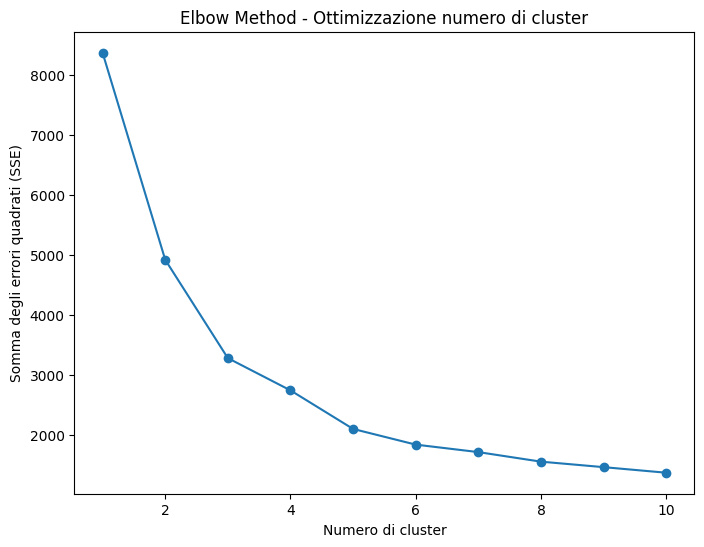

In [ ]:

# Creiamo un array di pesi basato sulla divisione 70-30

weights = np.array([
    2.0,  # Feature 3  -> Gruppo 70%
    1.0,  # Feature 4  -> Gruppo 30%
    2.0,  # Feature 7  -> Gruppo 70%
    2.0,  # Feature 8  -> Gruppo 70%
    1.0,  # Feature 9  -> Gruppo 30%
    2.0,  # Feature 14 -> Gruppo 70%
    2.0,  # Feature 15 -> Gruppo 70%
    1.0   # Feature 16 -> Gruppo 30%
])


# Applichiamo i pesi moltiplicando le feature
X_weighted = X * weights

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_weighted) #

wcss = []
max_clusters = 10

for i in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(X_scaled)
    wcss.append(kmeans.inertia_)

# Grafico Elbow
plt.figure(figsize=(8,6))
plt.plot(range(1, 11), wcss, marker='o')
plt.title("Elbow Method - Ottimizzazione numero di cluster")
plt.xlabel("Numero di cluster")
plt.ylabel("Somma degli errori quadrati (SSE)")
plt.show()

# 🔍 **Clusterizzazione e Visualizzazione dei Dati con K-Means e PCA**

In questa fase, applichiamo il **K-Means Clustering** per raggruppare i dati in 6 cluster, scelto in base al metodo Elbow, e riduciamo la dimensionalità dei dati a 2 componenti per visualizzare i cluster in un grafico 2D. Successivamente, il clustering viene visualizzato in uno scatter plot, dove i punti sono colorati in base al cluster di appartenenza.

<ipython-input-311-880ee25b3ee6>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset['Cluster'] = cluster_labels


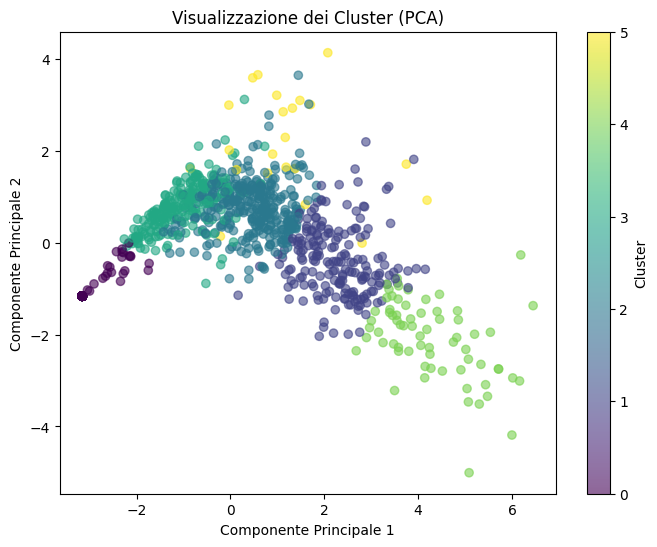

In [ ]:
# Imposta il numero di cluster scelto (6)
optimal_k = 6
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
cluster_labels = kmeans.fit_predict(X_scaled)

# Aggiungi le etichette dei cluster al dataset originale
dataset['Cluster'] = cluster_labels

# Riduci le 8 dimensioni a 2 componenti
pca = PCA(n_components=2)
principal_components = pca.fit_transform(X_scaled)

# Crea lo scatter plot, colorando i punti in base ai cluster
plt.figure(figsize=(8, 6))
plt.scatter(principal_components[:, 0], principal_components[:, 1], c=dataset['Cluster'], cmap='viridis', alpha=0.6)
plt.xlabel('Componente Principale 1')
plt.ylabel('Componente Principale 2')
plt.title('Visualizzazione dei Cluster (PCA)')
plt.colorbar(label='Cluster')
plt.show()

# 🔍 **Visualizzazione dei Cluster in 3D con PCA**

In questa fase, riduciamo ulteriormente le dimensioni del nostro dataset a **3 componenti principali** tramite **PCA (Principal Component Analysis)**, per ottenere una rappresentazione in 3D. Successivamente, visualizziamo i cluster utilizzando un grafico 3D, colorando i punti in base ai loro cluster di appartenenza.

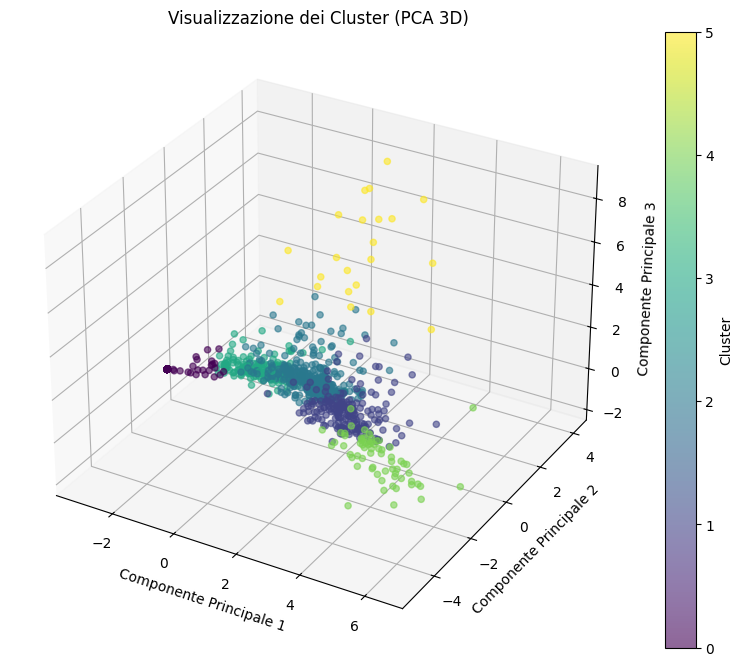

In [ ]:

# Riduci le 8 dimensioni a 3 componenti
pca = PCA(n_components=3)
principal_components = pca.fit_transform(X_scaled)

# Crea la figura e il grafico 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot dei cluster in 3D
scatter = ax.scatter(principal_components[:, 0], principal_components[:, 1], principal_components[:, 2],
                     c=dataset['Cluster'], cmap='viridis', alpha=0.6)

# Etichette e titolo
ax.set_xlabel('Componente Principale 1')
ax.set_ylabel('Componente Principale 2')
ax.set_zlabel('Componente Principale 3')
ax.set_title('Visualizzazione dei Cluster (PCA 3D)')

# Barra dei colori
cbar = plt.colorbar(scatter)
cbar.set_label('Cluster')

# Mostra il grafico
plt.show()


### 📌 **Visualizzazione dei Giocatori per Cluster**

Il codice seguente visualizza i giocatori in ciascun cluster, mostrando alcune delle loro statistiche più rilevanti. Ecco come funziona:

1. **Iterazione sui Cluster:**  
   Il ciclo `for cluster_id in range(optimal_k)` scorre ogni cluster creato dal modello di clustering. `optimal_k` è il numero di cluster scelto in precedenza (in questo caso 6).

2. **Selezione dei Giocatori nel Cluster:**  
   Per ogni cluster, viene selezionato il sottoinsieme del dataset contenente i giocatori appartenenti a quel cluster. Questo viene fatto utilizzando la condizione `dataset['Cluster'] == cluster_id`.

3. **Visualizzazione dei Dati per Cluster:**  
   Una volta selezionato il sottoinsieme di giocatori, il codice visualizza un subset di colonne contenenti statistiche come il `gamertag`, il `wlRatio`, il `gamesPlayed` e altre informazioni importanti.

In [ ]:
for cluster_id in range(optimal_k):  # 'optimal_k' è il numero di cluster
    cluster_players = dataset[dataset['Cluster'] == cluster_id]  # Seleziona i giocatori nel cluster
    print(f"Cluster {cluster_id}:")
    display(cluster_players[['gamertag', 'wlRatio', 'gamesPlayed', 'kdRatio', 'killstreak', 'totalLevelAccount', 'precisionHead', 'precisionAim', 'timePlayed']])  # Personalizza le colonne


Cluster 0:


,gamertag,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
0,RggRt45,0.0,0,0.0,0,1,0.0,0.0,0
10,BOBOQQ3,0.0,0,0.0,0,1,0.0,0.0,0
20,TawheedAhmed42,0.0,0,0.0,0,1,0.0,0.0,0
40,Manuel Alarcon1,0.0,0,0.0,0,1,0.0,0.0,0
49,leandr1nho13,0.0,0,0.0,0,1,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...
1525,Trymers,0.0,0,0.0,0,1,0.0,0.0,0
1530,YouFaShe,0.0,0,0.0,0,1,0.0,0.0,0
1543,라라찌,0.0,0,0.0,0,1,0.0,0.0,0
1554,Miguel_mor,0.0,0,0.0,0,1,0.0,0.0,0


Cluster 1:


,gamertag,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
5,Brxndoon7-LK,68.40,694,1.07,18,782,0.05,0.24,1366
12,CzarnyDelfinek,47.00,192,1.50,22,658,0.16,0.24,409
19,DeGiove,75.62,613,0.85,14,668,0.05,0.21,1153
26,HORUS REED,34.90,359,1.40,13,843,0.14,0.19,1621
39,SharkPawgin,49.38,655,0.85,14,749,0.04,0.20,1182
...,...,...,...,...,...,...,...,...,...
1528,allison__burgers,69.67,636,0.93,10,687,0.12,0.15,1348
1531,SPECTATOR,80.83,491,1.28,14,802,0.14,0.21,1590
1535,Richardcabreira8,55.25,450,0.61,9,763,0.09,0.09,2134
1545,anon67476781,56.17,343,0.99,13,327,0.07,0.14,748


Cluster 2:


,gamertag,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
15,DrunkUnc92,23.00,216,0.70,10,645,0.03,0.13,378
16,whoshotghost,9.64,117,0.95,17,646,0.04,0.19,255
18,LimpThaDon,23.75,198,1.01,13,642,0.05,0.19,421
21,teruteru_yt_,7.00,40,0.94,12,349,0.06,0.23,71
24,SlaPzz,6.00,49,0.94,9,629,0.11,0.27,78
...,...,...,...,...,...,...,...,...,...
1539,s0oReCkLeSsBrAh,17.62,149,1.02,13,642,0.04,0.15,284
1541,BlacKPoisoN,13.57,102,0.91,10,679,0.09,0.16,507
1546,Lekestrell,6.17,43,1.01,11,627,0.05,0.19,92
1548,AKR_aaa,7.56,77,0.94,9,633,0.09,0.26,153


Cluster 3:


,gamertag,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
6,bdooory_ab,2.00,6,0.63,4,6,0.06,0.11,8
7,ahevepluto,26.57,193,0.57,13,147,0.09,0.11,550
9,RPDUNKduo,6.50,30,0.44,7,12,0.04,0.17,44
14,SanDrasoSa,3.75,19,0.63,7,5,0.05,0.15,21
22,edgexgaming8901,10.20,56,0.69,11,12,0.04,0.20,92
...,...,...,...,...,...,...,...,...,...
1524,블랙오크,4.14,36,0.83,18,18,0.03,0.17,78
1536,haCap,6.00,21,1.01,10,14,0.05,0.15,66
1540,我带你们打,0.00,1,0.56,2,8,0.17,0.08,18
1549,MeaslyPanther81,3.83,29,0.82,12,65,0.07,0.21,65


Cluster 4:


,gamertag,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
8,MilkyLemonz-_-,25.55,770,1.04,26,790,0.05,0.20,2442
78,AskarkGG,50.53,773,1.04,15,793,0.07,0.23,1791
85,infamousabe84,80.44,733,0.97,20,857,0.08,0.13,2802
135,d3rdud32017,54.53,944,0.82,11,834,0.05,0.18,2157
137,悪夢 猿 猿怠惰な怠惰な,85.25,1380,0.93,20,772,0.07,0.17,2447
...,...,...,...,...,...,...,...,...,...
1488,CAT IN THE HAT,67.50,1096,0.87,15,837,0.07,0.24,3510
1505,MACONHEIRO_4i20,68.90,699,1.06,13,812,0.06,0.19,2040
1512,F4nton_M,73.55,820,0.87,14,745,0.08,0.15,1598
1533,Sterling Archer,57.38,1226,0.98,19,845,0.10,0.12,4022


Cluster 5:


,gamertag,wlRatio,gamesPlayed,kdRatio,killstreak,totalLevelAccount,precisionHead,precisionAim,timePlayed
200,GuiCaverzan,4.00,10,0.96,4,643,0.83,0.14,219
217,Quasimoto,40.67,125,0.79,6,698,0.50,0.19,711
238,koala750mortel,5.50,26,1.02,8,774,0.77,0.16,1473
241,Rocket1227,67.80,344,0.87,11,777,0.51,0.10,1852
352,Holydiver,0.00,2,1.09,7,633,0.82,0.08,116
558,Safaera,2.00,3,1.12,2,621,0.69,0.07,49
802,RedFury235,10.50,23,0.85,4,627,0.45,0.13,123
808,BigGunzGaming,26.64,387,1.88,11,956,0.42,0.21,2197
809,OlavFlame1,56.00,57,0.34,2,561,0.38,0.07,88
826,Ray_Moe21,38.14,274,0.66,6,742,0.51,0.15,1243


### 📌 **Descrizione dei Giocatori nel Dataset**

Nel nostro dataset, abbiamo rappresentato vari tipi di giocatori con diverse abilità e comportamenti nel gioco. Ecco una panoramica dei giocatori:

In [ ]:

player_debutante = {
    'gamertag': 'NoobPlayer01',
    'wlRatio': 2,
    'gamesPlayed': 2,
    'kdRatio': 0.6,
    'killstreak': 0,
    'totalLevelAccount': 1,
    'precisionHead': 0.1,
    'precisionAim': 0.05,
    'timePlayed': 1
}

player_2 = {
    'gamertag': 'ProGamerX',
    'wlRatio': 2.0,
    'gamesPlayed': 500,
    'kdRatio': 1.8,
    'killstreak': 20,
    'totalLevelAccount': 150,
    'precisionHead': 0.65,
    'precisionAim': 0.70,
    'timePlayed': 100
}

player_3 = {
    'gamertag': 'AverageJoe',
    'wlRatio': 1.2,
    'gamesPlayed': 200,
    'kdRatio': 1.0,
    'killstreak': 10,
    'totalLevelAccount': 50,
    'precisionHead': 0.40,
    'precisionAim': 0.50,
    'timePlayed': 50
}

player_4 = {
    'gamertag': 'WeekendWarrior',
    'wlRatio': 70.0,
    'gamesPlayed': 900,
    'kdRatio': 1.25,
    'killstreak': 20,
    'totalLevelAccount': 850,
    'precisionHead': 0.15,
    'precisionAim': 0.22,
    'timePlayed': 2500
}

player_5 = {
    'gamertag': 'SonoAbbastanzaForte67',
    'wlRatio': 22.0,
    'gamesPlayed': 215,
    'kdRatio': 0.71,
    'killstreak': 11,
    'totalLevelAccount': 642,
    'precisionHead': 0.04,
    'precisionAim': 0.14,
    'timePlayed': 379
}


player_6 = {
    'gamertag': 'MasterDestroyer89',
    'wlRatio': 3,
    'gamesPlayed': 1000,
    'kdRatio': 2.5,
    'killstreak': 30,
    'totalLevelAccount': 400,
    'precisionHead': 0.80,
    'precisionAim': 0.85,
    'timePlayed': 200
}

player_veterano = {
    'gamertag': 'NovaDestroyer42',
    'wlRatio': 25.0,
    'gamesPlayed': 250,
    'kdRatio': 1.35,
    'killstreak': 10,
    'totalLevelAccount': 800,
    'precisionHead': 0.85,
    'precisionAim': 0.60,
    'timePlayed': 1200
}

## Creazione di nuovi giocatori e predizione dei cluster

### 1. **Creazione del DataFrame con i nuovi giocatori**
Abbiamo definito un gruppo di nuovi giocatori con diverse caratteristiche, come il `gamertag`, `wlRatio`, `kdRatio`, `killstreak`, `totalLevelAccount`, `precisionHead`, `precisionAim`, e `timePlayed`.

### 2. **Rimozione della colonna `gamertag`**
Poiché la colonna `gamertag` non è utile per il clustering (essendo una stringa), è stata rimossa dal DataFrame prima di procedere con la normalizzazione.

### 3. **Normalizzazione delle caratteristiche**
Le caratteristiche numeriche dei nuovi giocatori sono state normalizzate utilizzando lo stesso scaler applicato ai dati originali. Questo è importante per garantire che le variabili siano su scala comparabile.

### 4. **Predizione dei cluster**
Utilizzando il modello `kmeans` precedentemente addestrato, abbiamo predetto i cluster a cui appartengono i nuovi giocatori.

### 5. **Assegnazione dei cluster**
Le etichette dei cluster previste sono state aggiunte al DataFrame dei nuovi giocatori come una nuova colonna denominata `Predicted Cluster`.

### 6. **Visualizzazione dei risultati**
Infine, abbiamo stampato i `gamertag` dei nuovi giocatori insieme ai cluster a cui sono stati assegnati, consentendo di osservare a quale gruppo di giocatori appartengono in base alle loro caratteristiche.

In [ ]:
# Creiamo un DataFrame con i nuovi giocatori
new_players = pd.DataFrame([player_debutante, player_2, player_3, player_4, player_5, player_6, player_veterano])

# Rimuoviamo il 'gamertag' dal DataFrame prima di normalizzarlo
new_players_features = new_players.drop(columns=['gamertag'])

# Normalizziamo le caratteristiche dei nuovi giocatori
new_players_scaled = scaler.transform(new_players_features)

# Predizione del cluster per ciascun nuovo giocatore
predicted_clusters = kmeans.predict(new_players_scaled)

# Assegniamo i cluster ai nuovi giocatori
new_players['Predicted Cluster'] = predicted_clusters

# Visualizziamo il risultato con il gamertag mantenuto
print(new_players[['gamertag', 'Predicted Cluster']])


                gamertag  Predicted Cluster
0           NoobPlayer01                  0
1              ProGamerX                  2
2             AverageJoe                  3
3         WeekendWarrior                  4
4  SonoAbbastanzaForte67                  2
5      MasterDestroyer89                  1
6        NovaDestroyer42                  5


# Creazione delle Lobby con KNN

In questo processo, stiamo creando delle lobby per i nuovi giocatori basandoci sul loro cluster assegnato tramite **KMeans** e selezionando i giocatori più simili utilizzando l'algoritmo **K-Nearest Neighbors (KNN)**. Ecco una panoramica delle fasi principali:

#### 1. Assegnazione del Cluster
Ogni nuovo giocatore è stato precedentemente assegnato a un cluster tramite il modello **KMeans**. Il cluster a cui appartiene ciascun giocatore è identificato tramite la colonna `Predicted Cluster`.

#### 2. Selezione dei Giocatori del Cluster
Una volta identificato il cluster di un giocatore, selezioniamo tutti gli altri giocatori appartenenti allo stesso cluster dal nostro dataset. Questo passaggio assicura che i giocatori siano raggruppati in base a caratteristiche simili.

#### 3. Normalizzazione dei Dati
Poiché le caratteristiche dei giocatori sono su scale diverse, utilizziamo un **scaler** (probabilmente un `StandardScaler` o simile) per normalizzare i dati. In questo modo, tutte le caratteristiche sono portate sulla stessa scala, prevenendo distorsioni nel calcolo delle distanze.

#### 4. Applicazione del KNN
Per selezionare i giocatori più simili, utilizziamo l'algoritmo **K-Nearest Neighbors (KNN)**. KNN è un algoritmo di apprendimento non supervisionato che cerca i punti più vicini a un punto dato (in questo caso, il nuovo giocatore).

- **Numero di vicini (n_neighbors)**: Definiamo il numero di giocatori da considerare come vicini, impostato a un massimo di 11. Questo significa che per ogni giocatore, il sistema cercherà i 11 giocatori più vicini nel cluster.

- **Calcolo delle distanze**: KNN calcola le distanze tra il giocatore in esame e gli altri giocatori del suo cluster, selezionando quelli più simili.

#### 5. Formazione della Lobby
Una volta selezionati i giocatori più vicini, la lobby viene creata con il nuovo giocatore aggiunto in cima alla lista. I giocatori selezionati tramite KNN completano la lobby, creando così un gruppo di giocatori con caratteristiche simili.

#### 6. Visualizzazione della Lobby
Infine, per ogni giocatore, viene creata una lobby e vengono stampati i dettagli del giocatore principale (il nuovo giocatore) e degli altri membri della lobby. La tabella mostra le caratteristiche principali come `gamertag`, `wlRatio`, `gamesPlayed`, `kdRatio`, ecc., per ogni giocatore nella lobby.

### Vantaggi dell'uso del KNN:
- **Personalizzazione delle lobby**: Ogni giocatore viene accoppiato con altri giocatori simili, migliorando l'esperienza di gioco.
- **Semplicità e efficienza**: KNN è relativamente facile da implementare e non richiede una fase di addestramento complessa.
- **Flessibilità**: KNN può essere adattato facilmente per variare il numero di vicini o le caratteristiche da considerare nel matchmaking.

In sintesi, **KNN** è utilizzato per creare delle lobby che raccolgono giocatori simili in base alle loro performance e abitudini di gioco, garantendo sessioni di gioco equilibrate e divertenti.


In [ ]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Creiamo le lobby per i due nuovi giocatori
lobbies = {}
features = ['wlRatio', 'gamesPlayed', 'kdRatio', 'killstreak',
            'totalLevelAccount', 'precisionHead', 'precisionAim', 'timePlayed']

for i, player in new_players.iterrows():
    cluster_id = player['Predicted Cluster']  # Cluster assegnato tramite KMeans
    player_data = player[features].values.reshape(1, -1)  # Caratteristiche numeriche per il calcolo

    # Selezioniamo tutti i giocatori che appartengono al cluster del giocatore corrente
    cluster_players = dataset[dataset['Cluster'] == cluster_id]

    # Rimuoviamo il giocatore principale dalla selezione
    cluster_players = cluster_players[cluster_players['gamertag'] != player['gamertag']]

    if cluster_players.empty:
        print(f"Cluster {cluster_id} vuoto o già processato, salto il giocatore {player['gamertag']}")
        continue

    # Normalizziamo i dati del giocatore e dei giocatori del cluster
    player_data_scaled = scaler.transform(player_data)
    cluster_players_scaled = scaler.transform(cluster_players[features])

    # Adattiamo il numero di vicini in base ai giocatori disponibili
    n_neighbors = min(len(cluster_players), 11)  # Max 11 vicini da aggiungere
    knn = NearestNeighbors(n_neighbors=n_neighbors)
    knn.fit(cluster_players_scaled)
    distances, indices = knn.kneighbors(player_data_scaled)

    # Selezioniamo i giocatori più vicini
    lobby_players = cluster_players.iloc[indices[0]].copy()

    # Aggiungiamo il nuovo giocatore in cima alla lista
    lobby_players = pd.concat([pd.DataFrame(player).T, lobby_players])

    # Salviamo la lobby per questo giocatore
    lobbies[f'Lobby_Player_{i}'] = lobby_players

# Stampiamo le lobby per ogni giocatore
for i, (lobby_name, lobby) in enumerate(lobbies.items(), start=1):
    print(f"\n===== {lobby_name} =====")

    # Otteniamo il giocatore principale
    main_player = lobby.iloc[0][['gamertag'] + features]

    # Stampa il giocatore principale con tabulate
    print("Giocatore principale:")
    print(tabulate([main_player.values], headers=['Gamertag'] + features, tablefmt='grid'))

    # Stampiamo gli altri membri della lobby
    other_players = lobby.iloc[1:][['gamertag'] + features]
    print("\nAltri giocatori nella lobby:")
    print(tabulate(other_players.values, headers=['Gamertag'] + features, tablefmt='grid'))



===== Lobby_Player_0 =====
Giocatore principale:
+--------------+-----------+---------------+-----------+--------------+---------------------+-----------------+----------------+--------------+
| Gamertag     |   wlRatio |   gamesPlayed |   kdRatio |   killstreak |   totalLevelAccount |   precisionHead |   precisionAim |   timePlayed |
+==============+===========+===============+===========+==============+=====================+=================+================+==============+
| NoobPlayer01 |         2 |             2 |       0.6 |            0 |                   1 |             0.1 |           0.05 |            1 |
+--------------+-----------+---------------+-----------+--------------+---------------------+-----------------+----------------+--------------+

Altri giocatori nella lobby:
+------------------+-----------+---------------+-----------+--------------+---------------------+-----------------+----------------+--------------+
| Gamertag         |   wlRatio |   gamesPlayed |   k

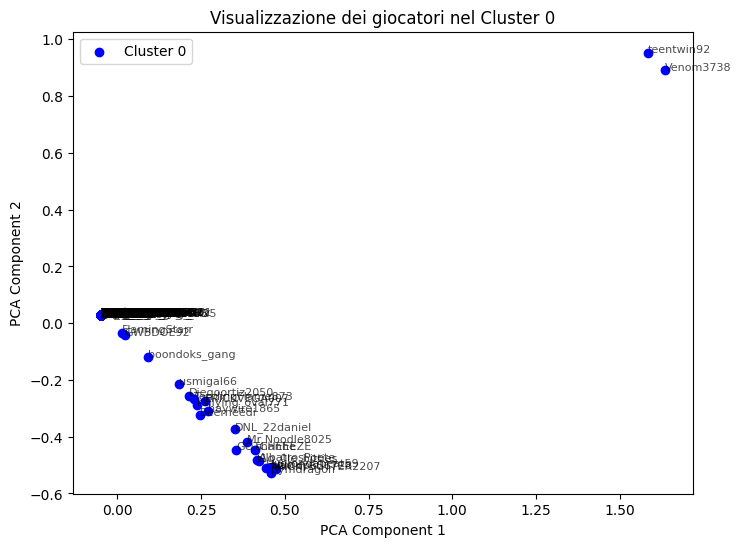

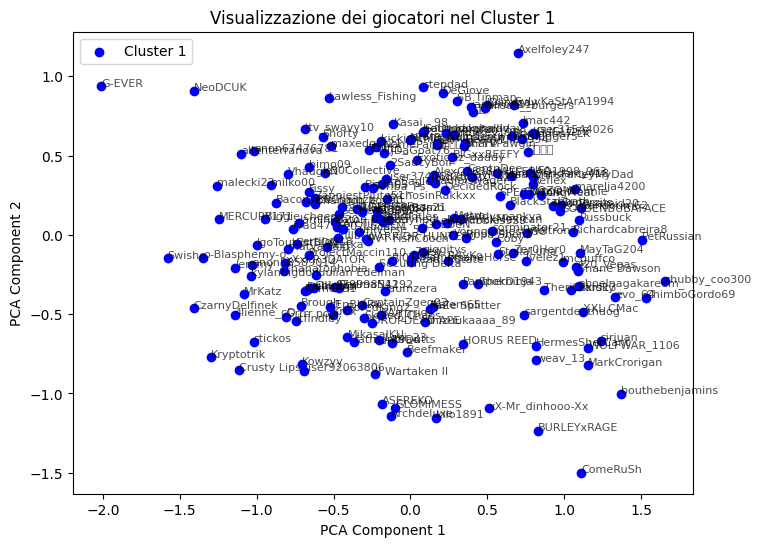

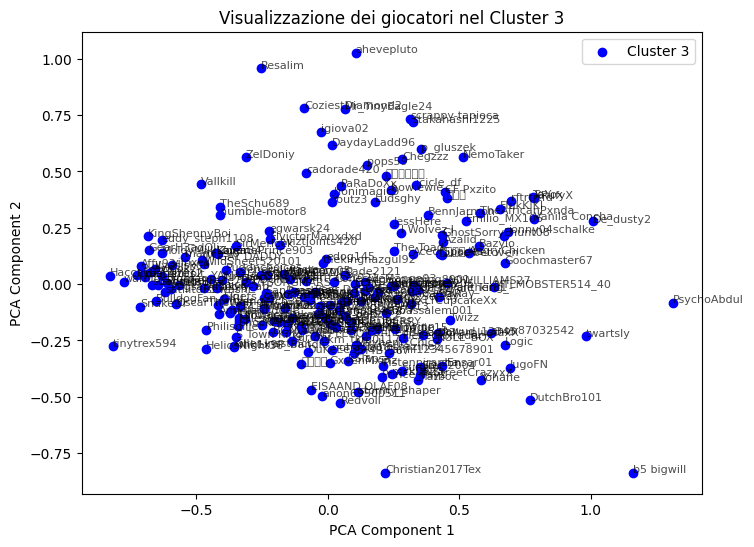

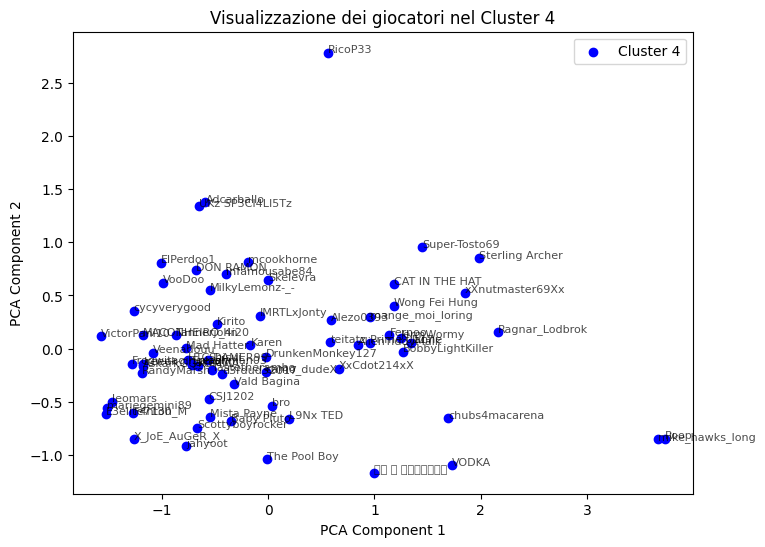

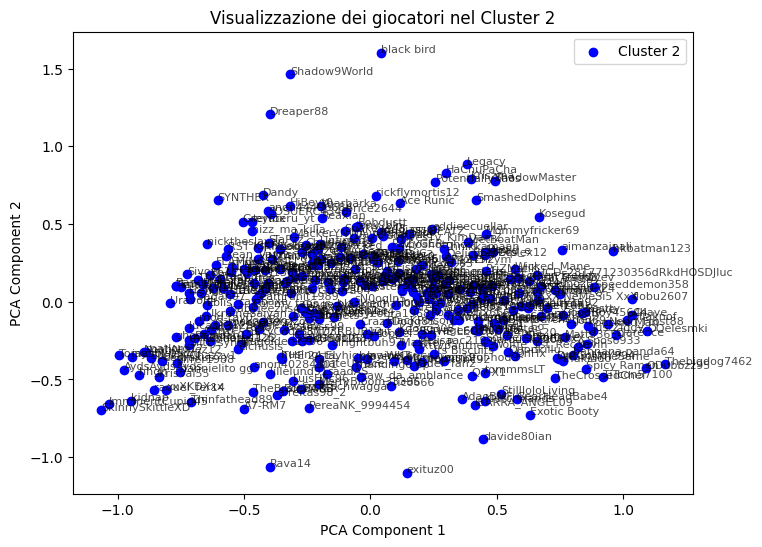

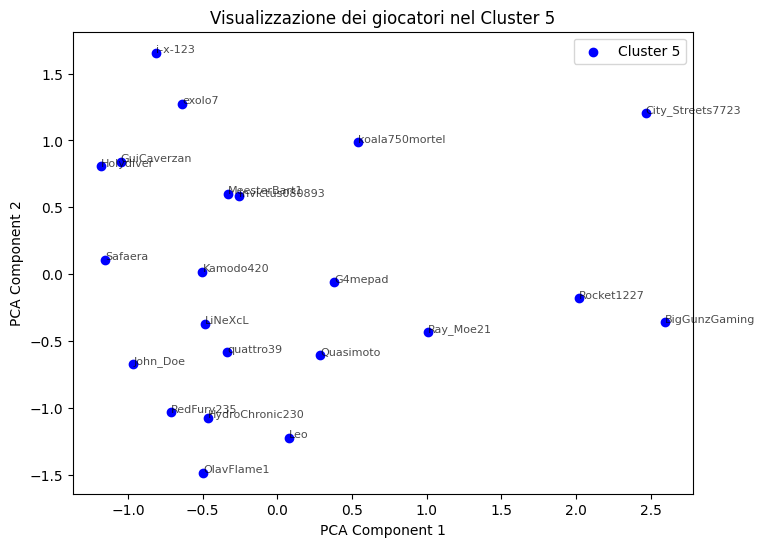

In [ ]:

import warnings
warnings.filterwarnings("ignore", category=UserWarning)


def plot_all_clusters():
    unique_clusters = dataset['Cluster'].unique()

    for cluster_n in unique_clusters:
        cluster_players = dataset[dataset['Cluster'] == cluster_n]
        if cluster_players.empty:
            continue

        # Applichiamo PCA per ridurre a 2D
        pca = PCA(n_components=2)
        reduced_data = pca.fit_transform(scaler.transform(cluster_players[features]))

        plt.figure(figsize=(8, 6))
        plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c='blue', label=f'Cluster {cluster_n}')

        # Etichette con i gamertag
        for i, txt in enumerate(cluster_players['gamertag']):
            plt.annotate(txt, (reduced_data[i, 0], reduced_data[i, 1]), fontsize=8, alpha=0.7)

        plt.xlabel("PCA Component 1")
        plt.ylabel("PCA Component 2")
        plt.title(f"Visualizzazione dei giocatori nel Cluster {cluster_n}")
        plt.legend()
        plt.show()
plot_all_clusters()


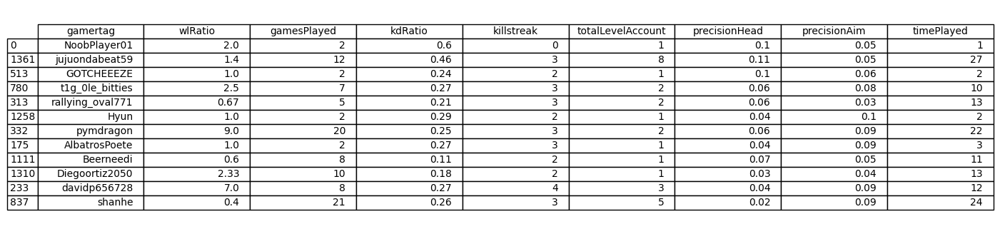

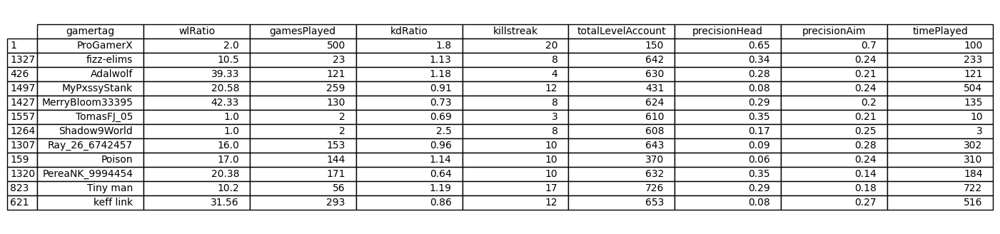

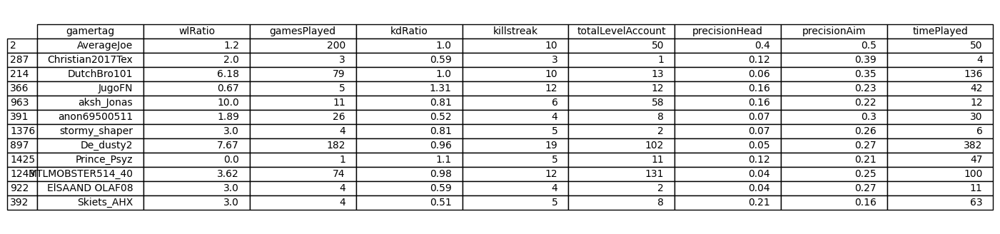

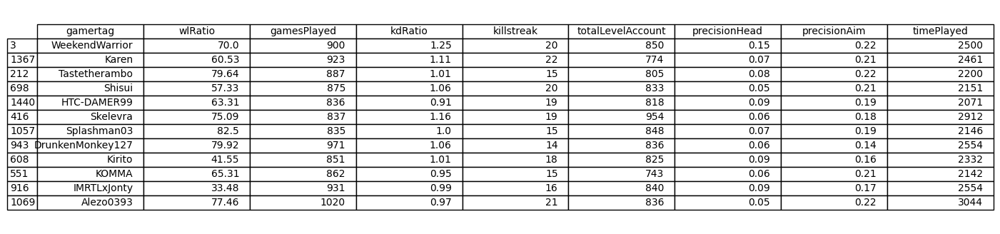

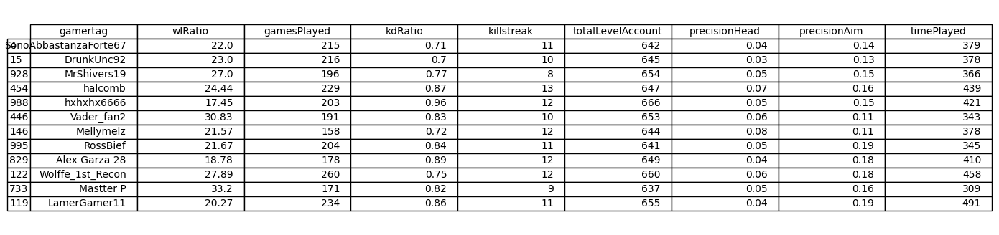

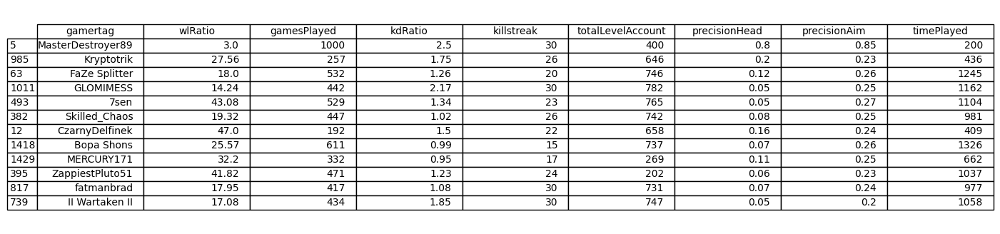

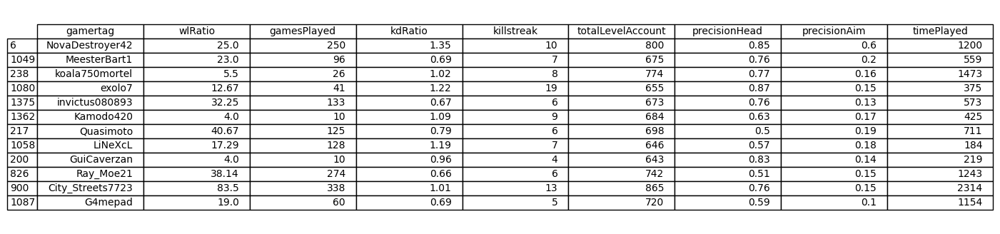

In [ ]:

# Funzione per salvare la tabella come immagine
def save_table_as_image(df, filename='table_image.png'):
    fig, ax = plt.subplots(figsize=(8, 4))  # Impostiamo la dimensione della figura
    ax.axis('tight')  # Disabilita gli assi
    ax.axis('off')  # Disabilita gli assi

    # Crea la tabella
    tab = table(ax, df, loc='center', colWidths=[0.2]*len(df.columns))

    # Personalizza la tabella
    tab.auto_set_font_size(False)  # Disabilita il ridimensionamento automatico del font
    tab.set_fontsize(10)  # Impostiamo la dimensione del font
    tab.scale(1.2, 1.2)  # Aumentiamo la scala della tabella per renderla più visibile

    # Salva l'immagine
    plt.savefig(filename, bbox_inches='tight', pad_inches=0.1)
    plt.close()  # Chiudiamo la figura per evitare che venga visualizzata due volte

# Iteriamo su tutte le lobby e salviamo ogni tabella come immagine
for i, (lobby_name, lobby) in enumerate(lobbies.items(), start=1):
    lobby_data = lobby[['gamertag'] + features]
    filename = f'lobby_{i}_table.png'  # Definiamo il nome del file per ogni lobby
    save_table_as_image(lobby_data, filename)  # Salviamo l'immagine della lobby

    # Mostriamo l'immagine nel notebook
    display(Image(filename=filename))


# Creazione delle Squadre per i Giocatori

In questo sistema, i giocatori all'interno di una lobby vengono separati in squadre da due, seguendo una distribuzione casuale. La funzione che gestisce questo processo è la `crea_squadre`, che divide i giocatori in due squadre, alternandoli in modo equo.

## Funzione `crea_squadre`

La funzione `crea_squadre` riceve due input:
- **`lobby`**: La lista di giocatori nella lobby.
- **`input_player`**: Il giocatore specifico da evidenziare (per esempio, il giocatore di input).

### Passaggi della Funzione:
1. **Selezione dei Giocatori**:
   - I giocatori vengono estratti dalle colonne delle caratteristiche numeriche (definite in `features`).
   - Successivamente, i giocatori vengono mescolati casualmente con `random.shuffle(players)` per evitare qualsiasi bias nella distribuzione.

2. **Creazione delle Squadre**:
   - Si creano due squadre vuote, `Rogue Black Ops` e `Crimson One`, all'interno di un dizionario.
   - I giocatori vengono assegnati alternativamente a ciascuna squadra, con il controllo che ogni squadra abbia lo stesso numero di giocatori.

3. **Evidenziazione del Giocatore di Input**:
   - Ogni volta che il giocatore di input (passato alla funzione) viene aggiunto alla lista, viene evidenziato con un asterisco (`*`), in modo da renderlo facilmente distinguibile.

4. **Stampa dei Risultati**:
   - La funzione stampa il nome di ciascuna squadra insieme ai membri, evidenziando il giocatore di input.

In [ ]:
# Funzione per separare i giocatori in squadre da 2
def crea_squadre(lobby, input_player):
    # Creiamo una lista di giocatori nella lobby
    players = lobby[features].values.tolist()

    # Mescoliamo i giocatori in modo casuale
    random.shuffle(players)

    # Creiamo le squadre
    squadre = {
        "Rogue Black Ops": [],
        "Crimson One": []
    }

    # Aggiungiamo i giocatori alle squadre
    for i in range(0, len(players), 2):
        # Alterniamo tra le due squadre
        squadra = "Rogue Black Ops" if i % 4 == 0 else "Crimson One"
        squadre[squadra].append(players[i:i+2])

    # Stampa delle squadre
    for squad_name, members in squadre.items():
        print(f"\n{squad_name}\n")
        for pair in members:
            for player in pair:
                # Troviamo il gamertag corrispondente
                gamertag = lobby.loc[lobby[features].apply(tuple, axis=1) == tuple(player), 'gamertag'].values[0]
                # Verifica se il giocatore è quello di input
                if player == input_player:
                    print(f"*{gamertag}* (Giocatore input)")  # Evidenziato
                else:
                    print(gamertag)  # Player normale

# Esempio: Per ogni lobby separa i giocatori in squadre
for i, (lobby_name, lobby) in enumerate(lobbies.items(), start=1):
    print(f"\n===== Lobby {i} =====")

    # Supponiamo che il primo giocatore della lobby sia quello di input
    input_player = lobby.iloc[0][features].values.tolist()  # O prendi il tuo giocatore specifico

    # Crea le squadre e stampa
    crea_squadre(lobby, input_player)



===== Lobby 1 =====

Rogue Black Ops

jujuondabeat59
rallying_oval771
Diegoortiz2050
AlbatrosPoete
pymdragon
shanhe

Crimson One

GOTCHEEEZE
Beerneedi
Hyun
t1g_0le_bitties
davidp656728
*NoobPlayer01* (Giocatore input)

===== Lobby 2 =====

Rogue Black Ops

fizz-elims
keff link
Shadow9World
MyPxssyStank
Tiny man
*ProGamerX* (Giocatore input)

Crimson One

Adalwolf
MerryBloom33395
Ray_26_6742457
Poison
TomasFJ_05
PereaNK_9994454

===== Lobby 3 =====

Rogue Black Ops

*AverageJoe* (Giocatore input)
Christian2017Tex
DutchBro101
Skiets_AHX
Prince_Psyz
anon69500511

Crimson One

JugoFN
stormy_shaper
MTLMOBSTER514_40
ElSAAND OLAF08
aksh_Jonas
De_dusty2

===== Lobby 4 =====

Rogue Black Ops

Tastetherambo
Skelevra
Splashman03
IMRTLxJonty
DrunkenMonkey127
KOMMA

Crimson One

Shisui
*WeekendWarrior* (Giocatore input)
Karen
Alezo0393
HTC-DAMER99
Kirito

===== Lobby 5 =====

Rogue Black Ops

hxhxhx6666
RossBief
MrShivers19
Alex Garza 28
*SonoAbbastanzaForte67* (Giocatore input)
Wolffe_1st_Recon



#**Dopo la fase di modeling, abbiamo l'evaluation.**

##**ORA STUDIAMO LE LOBBY**.
## Evaluation della Coerenza dei Cluster

L'evaluation nel contesto del clustering serve a misurare la coesione dei gruppi creati. Un buon clustering raggruppa i giocatori con skill simili, migliorando il bilanciamento delle partite.

### **Calcolo della Coesione dei Cluster**
1. **Calcolo della varianza interna al cluster**  
   - Si misura la deviazione standard media delle skill all'interno di ogni cluster.
  
2. **Normalizzazione della coesione**  
   - Si usa una scala percentuale inversa: minore è la varianza, maggiore è la coesione.  
   - Il valore di coesione (`giocabilità_percent`) è calcolato come:  
     \[
     100 - \left(\frac{\text{deviazione standard media del cluster}}{\text{deviazione standard massima del dataset}}\right) \times 100
     \]
  
3. **Visualizzazione grafica**  
   - Un grafico a barre mostra la coerenza di ciascun cluster.  
   - Una soglia (`40%`) viene indicata per evidenziare cluster con scarsa coesione.



===== Giocabilità nei Cluster =====
🎯 Cluster 0: 93.86% coerenza di skill
🎯 Cluster 1: 45.16% coerenza di skill
🎯 Cluster 2: 69.01% coerenza di skill
🎯 Cluster 3: 84.36% coerenza di skill
🎯 Cluster 4: 30.47% coerenza di skill
🎯 Cluster 5: 26.46% coerenza di skill


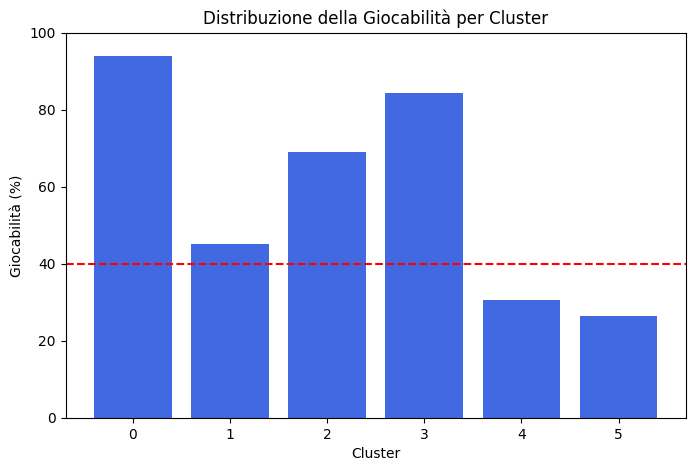

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Definiamo le feature chiave per valutare la skill
skill_features = ['wlRatio', 'kdRatio', 'precisionAim', 'totalLevelAccount', 'timePlayed']

# Creiamo un dizionario per salvare i risultati
cluster_coherence = {}

# Calcoliamo la varianza media per ogni cluster
for cluster_id in range(optimal_k):
    cluster_players = dataset[dataset['Cluster'] == cluster_id][skill_features]

    if cluster_players.empty:
        print(f"⚠️ Cluster {cluster_id} è vuoto, salto il calcolo.")
        continue

    # Calcoliamo la deviazione standard media tra i giocatori del cluster
    cluster_std = cluster_players.std().mean()

    # Normalizziamo la giocabilità: minore è la varianza, maggiore è la coesione
    # Usiamo una scala percentuale inversa (più bassa la std, più alta la percentuale di giocabilità)
    max_std = dataset[skill_features].std().mean()
    giocabilita_percent = max(0, 100 - (cluster_std / max_std) * 100)

    cluster_coherence[cluster_id] = giocabilita_percent

# Stampa i risultati
print("\n===== Giocabilità nei Cluster =====")
for cluster_id, giocabilita in cluster_coherence.items():
    print(f"🎯 Cluster {cluster_id}: {giocabilita:.2f}% coerenza di skill")

# Creiamo un grafico a barre per visualizzare la giocabilità nei cluster
plt.figure(figsize=(8,5))
plt.bar(cluster_coherence.keys(), cluster_coherence.values(), color='royalblue')
plt.axhline(y=40, color='r', linestyle='--', label="Soglia sbilanciamento")
plt.xlabel("Cluster")
plt.ylabel("Giocabilità (%)")
plt.title("Distribuzione della Giocabilità per Cluster")
plt.ylim(0, 100)
plt.xticks(range(optimal_k))
plt.show()


# Fairness e Evaluation nel Matchmaking

## Fairness nel Matchmaking

La fairness in un sistema di matchmaking si riferisce alla capacità di creare partite equilibrate, dove le squadre abbiano skill simili per garantire un'esperienza di gioco competitiva e divertente.  

### **Calcolo della Fairness**
Il codice divide i giocatori in due squadre casuali e calcola la fairness basandosi sulla media delle loro skill:

1. **Calcolo della skill media**  
   - Si prendono le feature chiave e si calcola la media per ciascuna squadra.
  
2. **Determinazione dello sbilanciamento**  
   - Si calcola il rapporto tra la squadra più forte e quella più debole.  
   - Se il valore è superiore a `1.4`, la partita viene considerata potenzialmente sbilanciata.

3. **Visualizzazione grafica**  
   - Si genera un grafico per mostrare il livello di fairness di ogni partita.  
   - Le partite con fairness score superiore a `1.4` vengono evidenziate in rosso.


===== Valutazione Fairness - Lobby_Player_0 =====
🔹 Fairness Score: 1.37 (Vicino a 1.4 è meglio)

===== Valutazione Fairness - Lobby_Player_1 =====
🔹 Fairness Score: 1.10 (Vicino a 1.4 è meglio)

===== Valutazione Fairness - Lobby_Player_2 =====
🔹 Fairness Score: 2.20 (Vicino a 1.4 è meglio)
⚠️ Attenzione: Partita potenzialmente sbilanciata!

===== Valutazione Fairness - Lobby_Player_3 =====
🔹 Fairness Score: 1.07 (Vicino a 1.4 è meglio)

===== Valutazione Fairness - Lobby_Player_4 =====
🔹 Fairness Score: 1.01 (Vicino a 1.4 è meglio)

===== Valutazione Fairness - Lobby_Player_5 =====
🔹 Fairness Score: 1.31 (Vicino a 1.4 è meglio)

===== Valutazione Fairness - Lobby_Player_6 =====
🔹 Fairness Score: 1.25 (Vicino a 1.4 è meglio)


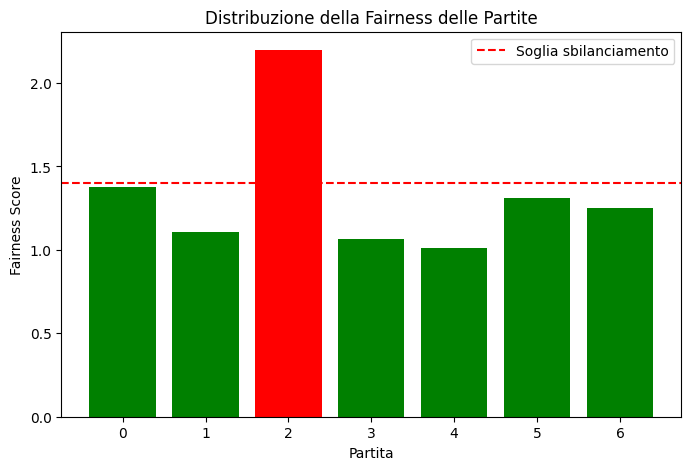

In [ ]:
import random

# Funzione per calcolare la fairness di una partita
def calcola_fairness(team1, team2):
    # Calcoliamo la media skill per team (usando le stesse feature di skill)
    team1_skill = team1[skill_features].mean().mean()
    team2_skill = team2[skill_features].mean().mean()

    # Calcoliamo il fairness score (rapporto tra il team più forte e quello più debole)
    fairness_score = max(team1_skill, team2_skill) / min(team1_skill, team2_skill)

    return fairness_score

# Funzione per generare le squadre e calcolare la fairness per ogni partita
def valuta_partite(lobbies):
    fairness_scores = []

    for i, (lobby_name, lobby) in enumerate(lobbies.items(), start=1):
        print(f"\n===== Valutazione Fairness - {lobby_name} =====")

        # Mischiamo casualmente i giocatori e dividiamoli in due squadre
        shuffled_players = lobby.sample(frac=1).reset_index(drop=True)
        metà = len(shuffled_players) // 2
        team1 = shuffled_players.iloc[:metà]
        team2 = shuffled_players.iloc[metà:]

        # Calcoliamo la fairness della partita
        fairness_score = calcola_fairness(team1, team2)
        fairness_scores.append(fairness_score)

        # Stampiamo il risultato
        print(f"🔹 Fairness Score: {fairness_score:.2f} (Vicino a 1.4 è meglio)")
        if fairness_score > 1.4:
            print("⚠️ Attenzione: Partita potenzialmente sbilanciata!")

    # Grafico della fairness di tutte le partite
    plt.figure(figsize=(8,5))
    plt.bar(range(len(fairness_scores)), fairness_scores, color=['green' if x <= 1.4 else 'red' for x in fairness_scores])
    plt.axhline(y=1.4, color='r', linestyle='--', label="Soglia sbilanciamento")
    plt.xlabel("Partita")
    plt.ylabel("Fairness Score")
    plt.title("Distribuzione della Fairness delle Partite")
    plt.legend()
    plt.show()

# Eseguiamo la valutazione
valuta_partite(lobbies)


## **Conclusione**
- Un matchmaking efficace si basa su **cluster coerenti** e **partite equilibrate al punto giusto**.  
- Un **fairness score vicino a 1.4** garantisce partite più competitive.  
- La **coesione dei cluster** aiuta a formare lobby con giocatori simili, migliorando la qualità del matchmaking.  

In [ ]:

#dataset.to_csv('/content/modified_dataset.csv', index=False)

#from google.colab import files
#files.download('/content/modified_dataset.csv')